# **Human Activity Recognition**

**Authors:**

- Fabio Scielzo Ortiz (100374708)
- Javier Rodriguez Valverde (100505911)

## **Index**

1. **Project Goal**
2. **Requirements**
3. **Data**
   - **Data description**
   - **Understanding the data**
4. **Getting the response and predictors**
5. **Imbalanced classification problem**
6. **Defining outer evaluation method**
7. **Pipelines definition**
8. **Defining inner evaluation method**
9. **Applying the inner evaluation**
    - **Selecting the best model**
10. **Applying the outer evaluation**
    - **Estimation of future performance**
11. **Last steps**
    - **Saving the model**
    - **Predicting the new data**
12. **Conclusions**

## **Project Goal**

The main goal of this project is to build an intelligent system able to recognize human activity in a given period of time (one second in our case) based on five different human signals (accelerometer z, x&y, and 3-axes gyroscope).

Therefore, the system will take  as input observations of those signals for humans measured in a given period of time, the the system will process them, segmenting them into one-second-blocks, later features of those blocks of signils will be extracted, and, finally, those features will be used as input by Machine earning algorithms, that will be able to recognize the activity done in that second, that is, to predict an activity for each block of signals.

In this way this system will be capable to recognize *second by second* what kind of activity a human is (streaming learning) or was (past learning) doing during a certain period of time.

In this project all the examples are *past learning*, but the implemented system would be able to predict one-second-blocks of signals collected in real time by an approapiate device for this task, like an smart watch.

The considered activities to be recognized are the following:

1. Running
2. Walking
3. Standing
4. Sitting
5. Lying


>**Project goal:** recognize human activity *per second*. That is, given some signals of a human recorded during certain period of time (like 15 minutes), recognize the activity that person was doing in each second of that period, considering a set of 5 possible of activities: *running, walking, standing, sitting, lying*. The system is suppose to be capable of processing data in real time, and therefore, recognize human activity in real time.

## **Requirements**

Libraries, functions and classes that are used along the project:

In [1]:
from scipy.io import loadmat, savemat
import numpy as np
import sys
import pickle
from scipy.stats import mode
from sklearn.model_selection import GroupKFold, cross_val_score
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import LinearSVC, SVC
from sklearn.ensemble import RandomForestClassifier, ExtraTreesClassifier, HistGradientBoostingClassifier
from lightgbm import LGBMClassifier
from xgboost import XGBClassifier
from sklearn.metrics import accuracy_score, balanced_accuracy_score, confusion_matrix, ConfusionMatrixDisplay
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.pipeline import Pipeline
from PIL import Image
from sklearn.preprocessing import LabelEncoder
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style('whitegrid')

In [2]:
sys.path.insert(0, r'C:\Users\fscielzo\Documents\Packages\PyMachineLearning_Package_Private')
from PyMachineLearning.evaluation import SimpleEvaluation
from PyMachineLearning.preprocessing import scaler

- Function to extract signals features based on block-segmentation, statistics and concatenation.

  This function uses raw signals data as input and returns a predictors matrix as output, suitable to be used with classic Machine Learning models.

In [3]:
def get_X_features_HAR(X_HAR, blocks_size, statistics, verbose=False):

    # X_HAR: list with the signals data matrix of each individual

    n_individuals = len(X_HAR)
    X_individual, signals_block = {}, {}

    for i in range(n_individuals):
        
        # signals matrix of i-th individual
        signals = X_HAR[i].T
        # num. samples for i-th individual
        n_samples = len(signals)
        # Time during which human activity was recorded
        if verbose:
            print(f'Time during which the activity of individual {i+1} of X_HAR was recorded:', np.round(n_samples/(blocks_size*60),3), 'mins.')
        # num. blocks to segmented data of i-th individual. 
        n_blocks = int(np.floor(n_samples/blocks_size))
        # number of samples not assigned to any block
        n_remaining_samples = n_samples - n_blocks*blocks_size
        
        # Segmenting the i-th individual data in blocks
        signals_block[i] = []
        for b in range(0, n_blocks):
            signals_block[i].append(signals[b*blocks_size:((b+1)*blocks_size),:])
        # Adding the remaining samples to the last block
        signals_block[i][-1] = np.row_stack([signals_block[i][-1], signals[-n_remaining_samples:,:]])

        # Computing statistics for each signal-data block and most frequent label per block for the i-th individual
        X_individual[i] = []
        for b in range(0, n_blocks):

            if statistics == 'mean':
                # mean of the signals features for i-th individual
                X_individual[i].append(np.mean(signals_block[i][b], axis=0))
        
            elif statistics == 'mean-std':
                # mean-std of the signals features for i-th individual
                X_features_mean = np.mean(signals_block[i][b], axis=0)
                X_features_std = np.std(signals_block[i][b], axis=0)
                X_individual[i].append(np.hstack([X_features_mean, X_features_std]))
          
            elif statistics == 'mean-median-std':
                # mean-std of the signals features for i-th individual
                X_features_mean = np.mean(signals_block[i][b], axis=0)
                X_features_median = np.median(signals_block[i][b], axis=0)
                X_features_std = np.std(signals_block[i][b], axis=0)
                X_individual[i].append(np.hstack([X_features_mean, X_features_median, X_features_std]))
      
            elif statistics == 'mean-Q25-median-Q75-std':
                # mean-std of the signals features for i-th individual
                X_features_mean = np.mean(signals_block[i][b], axis=0)
                X_features_Q25 = np.quantile(signals_block[i][b], q=0.25, axis=0)
                X_features_median = np.median(signals_block[i][b], axis=0)
                X_features_Q75 = np.quantile(signals_block[i][b], q=0.75, axis=0)
                X_features_std = np.std(signals_block[i][b], axis=0)
                X_individual[i].append(np.hstack([X_features_mean, X_features_Q25, X_features_median, X_features_Q75, X_features_std]))
        
        # Building an array with the signal statistics for each data-block, this is the features matrix for the i-th person. 
        # Rows represent one second and are the observations.
        # Columns represent a signal and are the features (predictors).
        X_individual[i] = np.array(X_individual[i])

    X = np.row_stack([X_individual[i] for i in X_individual.keys()])

    return X, X_individual, signals_block

- Function to process the given response data and making it compatible with the predictors matrix returned by the above function. This function follows a very similar approach to `get_X_features_HAR`, in a nutsell, it is based  on block-segmentation, the mode (as statistic) and concatenation.

  This function activity classes as input data and returns a response array with those classes processed correctly as output. This output could be used along with the predictors matrix given by `get_X_features_HAR` as the inputs of classic Machine Learning models.

In [4]:
def get_y_features_HAR(Y_HAR, blocks_size, verbose=False):

    # Y_HAR: list with the response vector of each person

    n_individuals = len(Y_HAR)
    Y_individual, classes_block = {}, {}

    for i in range(n_individuals):
        
        # response vector of i-th person
        classes = Y_HAR[i] 
        # num. samples for i-th person
        n_samples = len(classes)
        # Time during which human activity was recorded
        if verbose:
            print(f'Time during which the activity of person {i+1} of Y_HAR was recorded:', np.round(n_samples/(blocks_size*60),3), 'mins.')
        # num. blocks to segmented response vector of i-th person. 
        n_blocks = int(np.floor(n_samples/blocks_size))
        # number of samples not assigned to any block
        n_remaining_samples = n_samples - n_blocks*blocks_size
        
        # Segmenting the i-th person data in blocks
        # Each block represent {blocks_size/sampling_freq} second/s, since the sampling frequency represents 1 second.
        classes_block[i] = []
        for b in range(0, n_blocks):
            classes_block[i].append(classes[b*blocks_size:((b+1)*blocks_size)])
        # Adding the remaining samples to the last block
        classes_block[i][-1] = np.hstack([classes_block[i][-1], classes[-n_remaining_samples:]])

        # Computing statistics for each signal-data block and most frequent label per block for the i-th person
        Y_individual[i] = []
        for b in range(0, n_blocks):
            Y_individual[i].append(mode(classes_block[i][b])[0])
        
        # Building an array with the classes for each data-block, this is the response vector for the i-th person.
        Y_individual[i] = np.array(Y_individual[i])

    Y = np.concatenate([Y_individual[i] for i in Y_individual.keys()])

    return Y, Y_individual, classes_block

- A class that implements `get_X_features_HAR` following the `Sklearn` transformers rules. `FeaturesExtractionHAR`is indeed an `Sklearn` transformer.

In [5]:
class FeaturesExtractionHAR(BaseEstimator, TransformerMixin):

    def __init__(self, blocks_size, statistics, verbose=False):
       
        self.blocks_size = blocks_size
        self.statistics = statistics
        self.verbose = verbose

    def fit(self, X, y=None):

        return self
    
    def transform(self, X):

        X, self.X_individual, self.signals_block = get_X_features_HAR(X_HAR=X, blocks_size=self.blocks_size, 
                                                                      statistics=self.statistics, verbose=self.verbose)

        return X

## **Data**

### **Description fo the data**

The available data consist of 5 signals (accelerometer z, x&y, and 3-axes gyroscope) recorded on 8 individuals with a sampling frequency of 16 Hz, what means that each signal has been measured 16 times per second.

For example, if the signals were recorded during 15 minutes for a given individual, a total of (15*60 (secs))*16 = 14400 measures are taken, therefore, we will have a vector of 14400 observations (data points) of each signal for that individual.

The recording time of each signal for each person was lower than 20 minutes.

Along with the signals the activity carried out by the individuals in each considered fraction of time was also registered.

- **Predictors**: the signals.
- **Response**: the activities.

Besides, we have data regarding the signals for 2 additional individuals whose activity was not registered. One of the task will be to recognize what kind of activity those people were doing in each second of the recorded time. This data will play the role of new data to be predicted.

### **Understanding the data**

The dat is encapsulated as a `Matlab` file. We can load it using `loadmat` from `scipy`.

In [6]:
# Load the .mat file
HAR_database = loadmat(r'C:\Users\fscielzo\Documents\DataScience-GitHub\Human-Activity-Recognition\HAR_database\HAR_database.mat')

`HAR_database` is a dictionary with the following aspect:

In [536]:
HAR_database

{'__header__': b'MATLAB 5.0 MAT-file, Platform: MACI64, Created on: Tue May 16 10:33:21 2017',
 '__version__': '1.0',
 '__globals__': [],
 'database_training': array([[array([[ 0.02417325,  0.01990478,  0.03474859, ...,  0.15302195,
                  0.16644707,  0.13097667],
                [ 0.59441693,  0.60247182,  0.52582067, ...,  1.9454901 ,
                  2.00124793,  1.9890223 ],
                [-0.02273627, -0.01287489, -0.0200163 , ...,  0.00468276,
                 -0.00249675, -0.00409452],
                [ 0.11196179,  0.10379559,  0.10319319, ...,  0.11359097,
                  0.10181863,  0.10699662],
                [ 0.06049883,  0.05515676,  0.05754055, ...,  0.04945955,
                  0.06203927,  0.06837131]])                             ,
         array([[3, 3, 3, ..., 3, 3, 3]], dtype=uint8)],
        [array([[-0.00614456,  0.09416632,  0.02556427, ...,  0.25846636,
                  0.26831659,  0.20932986],
                [ 0.15163056,  0.27388097,  0

The keys of `HAR_database` are the following:

In [537]:
HAR_database.keys()

dict_keys(['__header__', '__version__', '__globals__', 'database_training', 'database_test'])

The available data for building the human activity recognition system is stored within `database_training`, and is an array of arrays.

It has 8 arrays (one per individual), and each array has 2 arrays as columns, the first with the signals data, the second with the activity data.

In [538]:
HAR_database['database_training']

array([[array([[ 0.02417325,  0.01990478,  0.03474859, ...,  0.15302195,
                 0.16644707,  0.13097667],
               [ 0.59441693,  0.60247182,  0.52582067, ...,  1.9454901 ,
                 2.00124793,  1.9890223 ],
               [-0.02273627, -0.01287489, -0.0200163 , ...,  0.00468276,
                -0.00249675, -0.00409452],
               [ 0.11196179,  0.10379559,  0.10319319, ...,  0.11359097,
                 0.10181863,  0.10699662],
               [ 0.06049883,  0.05515676,  0.05754055, ...,  0.04945955,
                 0.06203927,  0.06837131]])                             ,
        array([[3, 3, 3, ..., 3, 3, 3]], dtype=uint8)],
       [array([[-0.00614456,  0.09416632,  0.02556427, ...,  0.25846636,
                 0.26831659,  0.20932986],
               [ 0.15163056,  0.27388097,  0.24967994, ...,  1.01129501,
                 1.00222655,  0.94156865],
               [-0.02664025, -0.02277741, -0.00710769, ..., -0.02000222,
                -0.0194218 ,

In [539]:
HAR_database['database_training'].shape

(8, 2)

In [540]:
HAR_database['database_training'][0]

array([array([[ 0.02417325,  0.01990478,  0.03474859, ...,  0.15302195,
                0.16644707,  0.13097667],
              [ 0.59441693,  0.60247182,  0.52582067, ...,  1.9454901 ,
                2.00124793,  1.9890223 ],
              [-0.02273627, -0.01287489, -0.0200163 , ...,  0.00468276,
               -0.00249675, -0.00409452],
              [ 0.11196179,  0.10379559,  0.10319319, ...,  0.11359097,
                0.10181863,  0.10699662],
              [ 0.06049883,  0.05515676,  0.05754055, ...,  0.04945955,
                0.06203927,  0.06837131]])                             ,
       array([[3, 3, 3, ..., 3, 3, 3]], dtype=uint8)], dtype=object)

For example, the array with the signals data for the first individual is the following:


In [541]:
HAR_database['database_training'][0][0]

array([[ 0.02417325,  0.01990478,  0.03474859, ...,  0.15302195,
         0.16644707,  0.13097667],
       [ 0.59441693,  0.60247182,  0.52582067, ...,  1.9454901 ,
         2.00124793,  1.9890223 ],
       [-0.02273627, -0.01287489, -0.0200163 , ...,  0.00468276,
        -0.00249675, -0.00409452],
       [ 0.11196179,  0.10379559,  0.10319319, ...,  0.11359097,
         0.10181863,  0.10699662],
       [ 0.06049883,  0.05515676,  0.05754055, ...,  0.04945955,
         0.06203927,  0.06837131]])

There are 5 signals (rows) and 17736 measurements  for each signals.

In [542]:
HAR_database['database_training'][0][0].shape

(5, 17736)

Since the sampling frequency of the signals is 16 Hz, which represents 16 measurements per second, the time during which the signals were recorded for the first individual is 17736 / 16 = 1108.5 seconds, what means 18.48 minutes. So, the recording time of the signals for the first individual was 18.48 minutes.

In [543]:
sampling_freq = 16
(HAR_database['database_training'][0][0].shape[1] / sampling_freq) / 60

18.475

The array with the activities of the first individual is the following.

In [544]:
HAR_database['database_training'][0][1]

array([[3, 3, 3, ..., 3, 3, 3]], dtype=uint8)

Is a 1D array (vector) with 17736 components, that represent measurements of activity.

In [545]:
HAR_database['database_training'][0][1].shape

(1, 17736)

The i-th component of that vector indicates the activity that the first individual was doing in that specific fraction of time within those 18.48 minutes. Since each point represent a tiny fraction of time (1/16 = 0.063 seconds, approximately), is reasonable to find the same activity repeated many times in a row. For example, if the individual was standing in the first 50 seconds of the recording, the vector would have a 3 (label for standing) in its first 50*16 = 800 components. In other words, the first 800 measurements fo activity would correspond to standing.

## **Getting the response and predictors**

We are going to applied the procedure schematized in the below diagram to build the response and predictors arrays.

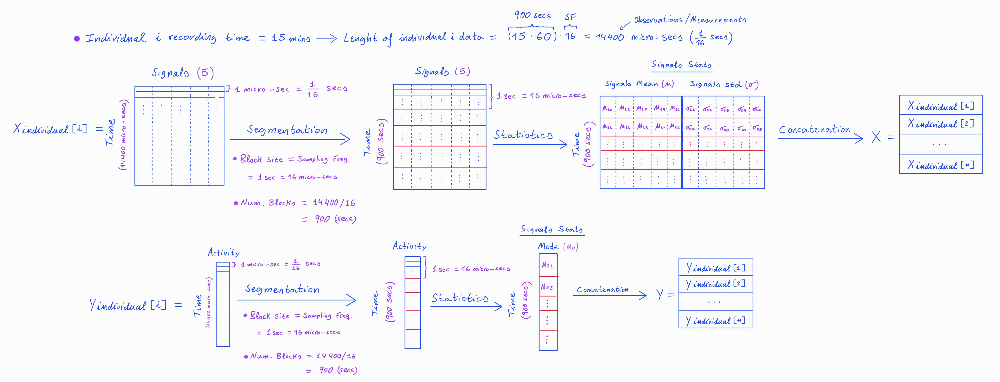

In [546]:
Image.open('images/diagram_.jpg')


This process is implemented by the class `FeaturesExtractionHAR` and the functions `get_X_features_HAR` and  `get_y_features_HAR`.

- `get_X_features_HAR` needs as input a list with the raw signals matrices of each individual.

- `FeaturesExtractionHAR` is a class based on `get_X_features_HAR` that follows the `Sklearn` transformers rules.

- `get_y_features_HAR` needs as input a list with raw activities vectors of each individual

Building the required lists:

In [547]:
sampling_freq = 16
n_individuals = len(HAR_database['database_training'])

X_HAR = [HAR_database['database_training'][i][0] for i in range(n_individuals)]
Y_HAR = [HAR_database['database_training'][i][1][0] for i in range(n_individuals)]

In [548]:
X_HAR

[array([[ 0.02417325,  0.01990478,  0.03474859, ...,  0.15302195,
          0.16644707,  0.13097667],
        [ 0.59441693,  0.60247182,  0.52582067, ...,  1.9454901 ,
          2.00124793,  1.9890223 ],
        [-0.02273627, -0.01287489, -0.0200163 , ...,  0.00468276,
         -0.00249675, -0.00409452],
        [ 0.11196179,  0.10379559,  0.10319319, ...,  0.11359097,
          0.10181863,  0.10699662],
        [ 0.06049883,  0.05515676,  0.05754055, ...,  0.04945955,
          0.06203927,  0.06837131]]),
 array([[-0.00614456,  0.09416632,  0.02556427, ...,  0.25846636,
          0.26831659,  0.20932986],
        [ 0.15163056,  0.27388097,  0.24967994, ...,  1.01129501,
          1.00222655,  0.94156865],
        [-0.02664025, -0.02277741, -0.00710769, ..., -0.02000222,
         -0.0194218 , -0.01871779],
        [-0.06663789, -0.08298231, -0.10177238, ..., -0.03517126,
         -0.04314523, -0.04061162],
        [ 0.24180082,  0.23684254,  0.24130693, ...,  0.24131465,
          0.23

In [549]:
Y_HAR

[array([3, 3, 3, ..., 3, 3, 3], dtype=uint8),
 array([3, 3, 3, ..., 3, 3, 3], dtype=uint8),
 array([3, 3, 3, ..., 3, 3, 3], dtype=uint8),
 array([3, 3, 3, ..., 3, 3, 3], dtype=uint8),
 array([3, 3, 3, ..., 3, 3, 3], dtype=uint8),
 array([3, 3, 3, ..., 3, 3, 3], dtype=uint8),
 array([3, 3, 3, ..., 3, 3, 3], dtype=uint8),
 array([3, 3, 3, ..., 3, 3, 3], dtype=uint8)]

### **Using a segmentation-statistics strategy**

In [550]:
X, X_individual, signals_block_individual = get_X_features_HAR(X_HAR=X_HAR, blocks_size=sampling_freq, statistics='mean-std', verbose=True)
Y, Y_individual, classes_block_individual = get_y_features_HAR(Y_HAR=Y_HAR, blocks_size=sampling_freq)

Time during which the activity of individual 1 of X_HAR was recorded: 18.475 mins.
Time during which the activity of individual 2 of X_HAR was recorded: 19.178 mins.
Time during which the activity of individual 3 of X_HAR was recorded: 18.167 mins.
Time during which the activity of individual 4 of X_HAR was recorded: 18.569 mins.
Time during which the activity of individual 5 of X_HAR was recorded: 17.625 mins.
Time during which the activity of individual 6 of X_HAR was recorded: 18.153 mins.
Time during which the activity of individual 7 of X_HAR was recorded: 18.808 mins.
Time during which the activity of individual 8 of X_HAR was recorded: 18.344 mins.


`signals_block_individual` contains  the defined  blocks of signals data for each individual.

In [551]:
signals_block_individual

{0: [array([[ 2.41732537e-02,  5.94416926e-01, -2.27362738e-02,
           1.11961786e-01,  6.04988253e-02],
         [ 1.99047773e-02,  6.02471816e-01, -1.28748934e-02,
           1.03795594e-01,  5.51567615e-02],
         [ 3.47485939e-02,  5.25820668e-01, -2.00162970e-02,
           1.03193191e-01,  5.75405492e-02],
         [ 5.98320129e-02,  6.21057101e-01, -2.68414140e-02,
           1.04378202e-01,  6.38529744e-02],
         [ 4.47425524e-02,  6.53000909e-01, -1.45401225e-02,
           1.03559958e-01,  6.60838166e-02],
         [ 4.75974340e-02,  6.13626139e-01, -1.58061659e-02,
           1.11281371e-01,  8.07137578e-02],
         [ 4.27921835e-02,  5.99051778e-01, -2.92630906e-02,
           1.04612408e-01,  7.14740148e-02],
         [ 8.60722067e-02,  6.72992949e-01, -7.92528632e-02,
           9.96278016e-02,  4.63797911e-02],
         [-2.51357734e-02,  7.15842468e-01, -1.05143449e-01,
           1.01205659e-01,  9.30532899e-02],
         [ 1.81585704e-02,  8.69505899e-01,

`signals_block_individual[0]` contains all the blocks of signals data for the first individual.

In [552]:
signals_block_individual[0]

[array([[ 2.41732537e-02,  5.94416926e-01, -2.27362738e-02,
          1.11961786e-01,  6.04988253e-02],
        [ 1.99047773e-02,  6.02471816e-01, -1.28748934e-02,
          1.03795594e-01,  5.51567615e-02],
        [ 3.47485939e-02,  5.25820668e-01, -2.00162970e-02,
          1.03193191e-01,  5.75405492e-02],
        [ 5.98320129e-02,  6.21057101e-01, -2.68414140e-02,
          1.04378202e-01,  6.38529744e-02],
        [ 4.47425524e-02,  6.53000909e-01, -1.45401225e-02,
          1.03559958e-01,  6.60838166e-02],
        [ 4.75974340e-02,  6.13626139e-01, -1.58061659e-02,
          1.11281371e-01,  8.07137578e-02],
        [ 4.27921835e-02,  5.99051778e-01, -2.92630906e-02,
          1.04612408e-01,  7.14740148e-02],
        [ 8.60722067e-02,  6.72992949e-01, -7.92528632e-02,
          9.96278016e-02,  4.63797911e-02],
        [-2.51357734e-02,  7.15842468e-01, -1.05143449e-01,
          1.01205659e-01,  9.30532899e-02],
        [ 1.81585704e-02,  8.69505899e-01, -9.50210008e-02,
    

The first individual has associated 1108 blocks, because the activity data regarding this individual was recorded during 18.475 minutes, and since each block represent one second since the `blocks_size=sample_freq`, then the number of blocks is approximately `18.475 (mins) * 60 (secs)`. 

In [553]:
len(signals_block_individual[0])

1108

In [554]:
18.475 * 60

1108.5

`signals_block_individual[0][0]` contains the first block of signals data for the first individual.

In [555]:
signals_block_individual[0][0]

array([[ 2.41732537e-02,  5.94416926e-01, -2.27362738e-02,
         1.11961786e-01,  6.04988253e-02],
       [ 1.99047773e-02,  6.02471816e-01, -1.28748934e-02,
         1.03795594e-01,  5.51567615e-02],
       [ 3.47485939e-02,  5.25820668e-01, -2.00162970e-02,
         1.03193191e-01,  5.75405492e-02],
       [ 5.98320129e-02,  6.21057101e-01, -2.68414140e-02,
         1.04378202e-01,  6.38529744e-02],
       [ 4.47425524e-02,  6.53000909e-01, -1.45401225e-02,
         1.03559958e-01,  6.60838166e-02],
       [ 4.75974340e-02,  6.13626139e-01, -1.58061659e-02,
         1.11281371e-01,  8.07137578e-02],
       [ 4.27921835e-02,  5.99051778e-01, -2.92630906e-02,
         1.04612408e-01,  7.14740148e-02],
       [ 8.60722067e-02,  6.72992949e-01, -7.92528632e-02,
         9.96278016e-02,  4.63797911e-02],
       [-2.51357734e-02,  7.15842468e-01, -1.05143449e-01,
         1.01205659e-01,  9.30532899e-02],
       [ 1.81585704e-02,  8.69505899e-01, -9.50210008e-02,
         1.11931738e-01

In [556]:
signals_block_individual[0][0].shape

(16, 5)

`signals_block_individual[0][2]` contains the third block of signals data for the first individual.

In [557]:
signals_block_individual[0][2]

array([[ 0.05603331,  0.53029042,  0.01934483,  0.11045798,  0.04319037],
       [ 0.04963319,  0.51433076,  0.00830888,  0.11048016,  0.02880013],
       [ 0.02862443,  0.51042654,  0.00441286,  0.11152631,  0.02093459],
       [ 0.00882263,  0.45604613, -0.0059629 ,  0.10417648,  0.02131418],
       [ 0.01667981,  0.4761595 , -0.01400896,  0.10553487,  0.045963  ],
       [ 0.02642862,  0.4581321 , -0.01897237,  0.11587779,  0.06677644],
       [ 0.05100351,  0.45989142, -0.02613971,  0.10646909,  0.08025166],
       [ 0.05723173,  0.47876043, -0.03667004,  0.10802934,  0.09362343],
       [ 0.038007  ,  0.55108577, -0.03700678,  0.10702783,  0.11128936],
       [ 0.04394006,  0.51514546, -0.02416446,  0.11626003,  0.09354207],
       [ 0.04164859,  0.56611433, -0.02531067,  0.10683497,  0.06726321],
       [ 0.03825797,  0.53338986, -0.02089029,  0.10345215,  0.06435183],
       [ 0.04174467,  0.53574655, -0.0228516 ,  0.10338284,  0.03382761],
       [ 0.03180509,  0.55494041, -0.0

In [558]:
signals_block_individual[0][2].shape

(16, 5)

In the feature extraction part, statistics are computed over the columns of these blocks leading to a vector of statistics for each block.

For example, `X_individual[0][2]` contains that vector of statistics (meand-std in this case) computed over `signals_block_individual[0][2]`

In [559]:
X_individual[0][2]

array([ 0.0369589 ,  0.51999355, -0.01568391,  0.10837755,  0.05546055,
        0.01307035,  0.04540661,  0.01498785,  0.0037611 ,  0.02738979])

`X_individual` contains statistics of each signal within each block of signals data , for each individual. In this case the statistics used are the mean and std.


In [560]:
X_individual

{0: array([[ 0.03365261,  0.68006947, -0.03290837, ...,  0.03137443,
          0.00674869,  0.07465121],
        [ 0.02045495,  0.73399091,  0.01038365, ...,  0.02361024,
          0.00949732,  0.05903554],
        [ 0.0369589 ,  0.51999355, -0.01568391, ...,  0.01498785,
          0.0037611 ,  0.02738979],
        ...,
        [ 0.13095113,  2.04631957, -0.00542365, ...,  0.00836883,
          0.00722404,  0.02061125],
        [ 0.12373219,  2.10951935, -0.00282314, ...,  0.01206207,
          0.00446198,  0.01002007],
        [ 0.12730595,  2.04735858,  0.0047647 , ...,  0.00939929,
          0.00602465,  0.01844863]]),
 1: array([[ 0.02552456,  0.21004328, -0.01343678, ...,  0.00722181,
          0.01536981,  0.01618562],
        [ 0.02349105,  0.26255908, -0.01435662, ...,  0.00677772,
          0.0155398 ,  0.01864301],
        [ 0.0157643 ,  0.27034967, -0.02089435, ...,  0.00927781,
          0.01498527,  0.02505213],
        ...,
        [ 0.2404649 ,  0.9297338 , -0.02188205, 


`X_individual[i]` contains the signals stats for each block in which signals data of i-th individual was segmented. Each block represent 1 second in this case since `blocks_size=sampling_freq`. 


In [561]:
X_individual[0]

array([[ 0.03365261,  0.68006947, -0.03290837, ...,  0.03137443,
         0.00674869,  0.07465121],
       [ 0.02045495,  0.73399091,  0.01038365, ...,  0.02361024,
         0.00949732,  0.05903554],
       [ 0.0369589 ,  0.51999355, -0.01568391, ...,  0.01498785,
         0.0037611 ,  0.02738979],
       ...,
       [ 0.13095113,  2.04631957, -0.00542365, ...,  0.00836883,
         0.00722404,  0.02061125],
       [ 0.12373219,  2.10951935, -0.00282314, ...,  0.01206207,
         0.00446198,  0.01002007],
       [ 0.12730595,  2.04735858,  0.0047647 , ...,  0.00939929,
         0.00602465,  0.01844863]])

In [562]:
X_individual[0].shape

(1108, 10)

In [563]:
X_individual[1]

array([[ 0.02552456,  0.21004328, -0.01343678, ...,  0.00722181,
         0.01536981,  0.01618562],
       [ 0.02349105,  0.26255908, -0.01435662, ...,  0.00677772,
         0.0155398 ,  0.01864301],
       [ 0.0157643 ,  0.27034967, -0.02089435, ...,  0.00927781,
         0.01498527,  0.02505213],
       ...,
       [ 0.2404649 ,  0.9297338 , -0.02188205, ...,  0.00374384,
         0.00814611,  0.01080869],
       [ 0.24607284,  0.93328066, -0.02392841, ...,  0.00638742,
         0.00831582,  0.02118794],
       [ 0.24291153,  0.93360847, -0.02426387, ...,  0.00710508,
         0.00533481,  0.03115763]])

In [564]:
X_individual[1].shape

(1150, 10)

`X_individual[0]` and `X_individual[1]` has a different number of rows since the recording times for individual 0 and 1 are not the same. 

Signals were recorded during 18.48 minutes for individual 1, while were 19.18 minutes for individual 2. This cause that difference in the number of blocks, and therefore ein the number of rows.


`X[i][j,:]` contains the signals stats for the fir the j-th second of data recorded for the i-th individual.

For example, the first individual was recorded 18.48 minutes, so, we have 16 observations of the signals for each second of those 18.48, since the sampling frequency was 16 Hz.  Then we have segmented that data in blog of a size equal to the sampling frequency, that is, blocks of 16 observations (rows). Then statistics like the mean and standard deviation are computed within each block (by columns). Then, each block has been transformed in a signals stats vector, which represent the signals stats of the individual in a given second of the recording. The signals stats vectors will be the data observations.

A similar procedure was applied to the activities data, but using the mode to transform the blocks into vectors. Therefore, the most frequent activity within a block will represent that block, and will be considered the response observation associated to the specific second linked to the block.

Examples:

-  `X_individual[2][15,:]` is the signals stats vector of the individual 3 in the second 16 of the recording.

- `Y_individual[2][15]` is the most frequent activity done by individual 3 in the second 16 of the recording.

In [565]:
X_individual[2][15,:]

array([ 0.09538123,  0.83600318,  0.02143199, -0.0570608 , -0.09876293,
        0.01846191,  0.03842564,  0.00916219,  0.01059745,  0.0141913 ])

In [566]:
Y_individual[2][15]

3


`X` is the result of concatenating the arrays of `X_individual` by rows.

Therefore `X` is predictors matrix where each row contains the signals statistics for a certain individual in a specific second. These rows represent observations, and he columns, that contain a signal statistics for each second of the recorded data for each available individual, represent the predictor variables.

In [567]:
X

array([[ 0.03365261,  0.68006947, -0.03290837, ...,  0.03137443,
         0.00674869,  0.07465121],
       [ 0.02045495,  0.73399091,  0.01038365, ...,  0.02361024,
         0.00949732,  0.05903554],
       [ 0.0369589 ,  0.51999355, -0.01568391, ...,  0.01498785,
         0.0037611 ,  0.02738979],
       ...,
       [ 0.57247732,  1.83496397, -0.08331397, ...,  0.00445178,
         0.00591461,  0.00764645],
       [ 0.56999553,  1.84273059, -0.07963554, ...,  0.00479656,
         0.00320455,  0.00933258],
       [ 0.5736782 ,  1.84422192, -0.08041299, ...,  0.00561236,
         0.00471552,  0.00715709]])

In [568]:
X.shape

(8836, 10)

Another way to obtain the predictors matrix `X` is using the class `FeaturesExtractionHAR` that follows the `Sklearn` rules for transformers.

In [569]:
features_extraction_HAR = FeaturesExtractionHAR(blocks_size=sampling_freq, statistics='mean-std')
X = features_extraction_HAR.fit_transform(X=X_HAR)

In [570]:
X

array([[ 0.03365261,  0.68006947, -0.03290837, ...,  0.03137443,
         0.00674869,  0.07465121],
       [ 0.02045495,  0.73399091,  0.01038365, ...,  0.02361024,
         0.00949732,  0.05903554],
       [ 0.0369589 ,  0.51999355, -0.01568391, ...,  0.01498785,
         0.0037611 ,  0.02738979],
       ...,
       [ 0.57247732,  1.83496397, -0.08331397, ...,  0.00445178,
         0.00591461,  0.00764645],
       [ 0.56999553,  1.84273059, -0.07963554, ...,  0.00479656,
         0.00320455,  0.00933258],
       [ 0.5736782 ,  1.84422192, -0.08041299, ...,  0.00561236,
         0.00471552,  0.00715709]])

In [571]:
X.shape

(8836, 10)


`Y` is the result of concatenating the arrays of `Y_person` to form a single vector.

Therefore `Y` is response vector where each component indicates the activity that the certain individual was doing in an specific second

In [572]:
Y

array([3, 3, 3, ..., 3, 3, 3], dtype=uint8)

In [573]:
Y.shape

(8836,)

## **Imbalance classification problem**

In [574]:
unique_values, frequencies = np.unique(Y, return_counts=True)
print(f'Unique values of the response and their frequencies in the available data: {dict(zip(unique_values,frequencies))}')

Unique values of the response and their frequencies in the available data: {1: 300, 2: 1836, 3: 2613, 4: 2536, 5: 1551}


The classification problem is imbalance since the frequencies distribution of the response variable is imbalance.

These is an important fact to consider since affects to both the ML models and the error metric. 

- **Error metric:** in imbalanced problems accuracy is bias by the most dominant classes of the response, and, therefore, it mostly reflects the predictive performance of the models in those dominant classes, so that, if a model perform outstanding in the dominant clases but poorly in the not dominant the accuracy will be outstanding when it shouldn't be like this. 
To mitigate this issue *balanced accuracy* will be used.

- **Models:** in imbalanced classification problems ML models usually learn patterns related with the dominant classes, and due to this perform well classifying instances belonging to dominant classes but poorly those belonging to not dominant. To overcome this issue there are several strategies like *over/under sampling* and *weighting observations* according to classes frequencies. In this project the second approach will be considered for certain models.

## **Defining outer evaluation method**

### **Train-Test Split**

In [575]:
train_prop = 0.85
train_size = int(np.round(train_prop*n_individuals))
individuals_idx = range(n_individuals)
np.random.seed(123)
train_individuals = np.random.choice(individuals_idx, train_size, replace=False)
test_individuals = np.array([x for x in individuals_idx if x not in train_individuals])

In [576]:
train_individuals

array([0, 1, 3, 7, 4, 2, 5])

In [577]:
len(train_individuals)

7

In [578]:
test_individuals

array([6])

In [579]:
len(test_individuals)

1

Building the training a testing lists `X_HAR` and `Y_HAR` defined above. The same as before but considering training and testing individuals separately.

In [580]:
X_HAR_train = [HAR_database['database_training'][i][0] for i in train_individuals]
Y_HAR_train = [HAR_database['database_training'][i][1][0] for i in train_individuals]

X_HAR_test = [HAR_database['database_training'][i][0] for i in test_individuals]
Y_HAR_test = [HAR_database['database_training'][i][1][0] for i in test_individuals]

The training raw signals matrices list:

In [581]:
X_HAR_train

[array([[ 0.02417325,  0.01990478,  0.03474859, ...,  0.15302195,
          0.16644707,  0.13097667],
        [ 0.59441693,  0.60247182,  0.52582067, ...,  1.9454901 ,
          2.00124793,  1.9890223 ],
        [-0.02273627, -0.01287489, -0.0200163 , ...,  0.00468276,
         -0.00249675, -0.00409452],
        [ 0.11196179,  0.10379559,  0.10319319, ...,  0.11359097,
          0.10181863,  0.10699662],
        [ 0.06049883,  0.05515676,  0.05754055, ...,  0.04945955,
          0.06203927,  0.06837131]]),
 array([[-0.00614456,  0.09416632,  0.02556427, ...,  0.25846636,
          0.26831659,  0.20932986],
        [ 0.15163056,  0.27388097,  0.24967994, ...,  1.01129501,
          1.00222655,  0.94156865],
        [-0.02664025, -0.02277741, -0.00710769, ..., -0.02000222,
         -0.0194218 , -0.01871779],
        [-0.06663789, -0.08298231, -0.10177238, ..., -0.03517126,
         -0.04314523, -0.04061162],
        [ 0.24180082,  0.23684254,  0.24130693, ...,  0.24131465,
          0.23

The testing raw signals matrices list:

In [582]:
X_HAR_test

[array([[ 0.06971024,  0.06352591,  0.07675852, ...,  0.27126796,
          0.16124686,  0.19524657],
        [ 0.39471738,  0.40493709,  0.43956792, ...,  1.27376087,
          1.31028354,  1.25608528],
        [-0.11659078, -0.11212781, -0.10438286, ..., -0.06724237,
         -0.08350385, -0.06953112],
        [ 0.06578621,  0.0653771 ,  0.06778922, ...,  0.09091548,
          0.09260207,  0.09608102],
        [ 0.06120889,  0.05849763,  0.05579525, ...,  0.06037664,
          0.05157136,  0.03467293]])]

The training raw activities vectors list:

In [583]:
Y_HAR_train

[array([3, 3, 3, ..., 3, 3, 3], dtype=uint8),
 array([3, 3, 3, ..., 3, 3, 3], dtype=uint8),
 array([3, 3, 3, ..., 3, 3, 3], dtype=uint8),
 array([3, 3, 3, ..., 3, 3, 3], dtype=uint8),
 array([3, 3, 3, ..., 3, 3, 3], dtype=uint8),
 array([3, 3, 3, ..., 3, 3, 3], dtype=uint8),
 array([3, 3, 3, ..., 3, 3, 3], dtype=uint8)]

The testing raw activities vectors list:

In [584]:
Y_HAR_test

[array([3, 3, 3, ..., 3, 3, 3], dtype=uint8)]

Getting the training and testing predictor matrices and response vectors, using different statistics for feature extraction.

In [585]:
X_train, X_test = {}, {}
statistics_grid = ['mean', 'mean-std', 'mean-median-std', 'mean-Q25-median-Q75-std']
for stat in statistics_grid:
    features_extraction = FeaturesExtractionHAR(blocks_size=sampling_freq, statistics=stat)
    X_train[stat] = features_extraction.transform(X=X_HAR_train)
    X_test[stat] = features_extraction.transform(X=X_HAR_test)

In [586]:
Y_train, Y_train_person, _ = get_y_features_HAR(Y_HAR=Y_HAR_train, blocks_size=sampling_freq)
groups_idx_train = np.concatenate([np.full(len(Y_train_person[i]), i) for i in Y_train_person.keys()]) 
n_groups_train = len(np.unique(groups_idx_train))

Y_test, _, _ = get_y_features_HAR(Y_HAR=Y_HAR_test, blocks_size=sampling_freq)

# Codifying the response as {1:0, 2:1, 3:2, 4:3, 5:4} to avoid problems with certain models like XGBoost
label_encoder = LabelEncoder()
Y_train = label_encoder.fit_transform(Y_train)
Y_test = label_encoder.fit_transform(Y_test)

The training predictors matrix when using `mean` as statistic in the features extraction method:

In [587]:
X_train['mean']

array([[ 0.03365261,  0.68006947, -0.03290837,  0.10579754,  0.0847926 ],
       [ 0.02045495,  0.73399091,  0.01038365,  0.10670424,  0.01609113],
       [ 0.0369589 ,  0.51999355, -0.01568391,  0.10837755,  0.05546055],
       ...,
       [ 0.13476305,  0.76418404, -0.15004717,  0.01154583, -0.09196487],
       [ 0.14829756,  0.6773758 , -0.13221036,  0.01025543, -0.06299339],
       [ 0.15518139,  0.6740382 , -0.12196696, -0.00395498,  0.06063506]])

In [588]:
X_train['mean'].shape

(7708, 5)

The training predictors matrix when using `mean` and `std` as statistic in the features extraction method:

In [589]:
X_train['mean-std']

array([[ 0.03365261,  0.68006947, -0.03290837, ...,  0.03137443,
         0.00674869,  0.07465121],
       [ 0.02045495,  0.73399091,  0.01038365, ...,  0.02361024,
         0.00949732,  0.05903554],
       [ 0.0369589 ,  0.51999355, -0.01568391, ...,  0.01498785,
         0.0037611 ,  0.02738979],
       ...,
       [ 0.13476305,  0.76418404, -0.15004717, ...,  0.01909474,
         0.00966084,  0.03784605],
       [ 0.14829756,  0.6773758 , -0.13221036, ...,  0.01038249,
         0.008176  ,  0.01989335],
       [ 0.15518139,  0.6740382 , -0.12196696, ...,  0.02631454,
         0.02744556,  0.20666895]])

In [590]:
X_train['mean-std'].shape

(7708, 10)

In [591]:
X_HAR_test

[array([[ 0.06971024,  0.06352591,  0.07675852, ...,  0.27126796,
          0.16124686,  0.19524657],
        [ 0.39471738,  0.40493709,  0.43956792, ...,  1.27376087,
          1.31028354,  1.25608528],
        [-0.11659078, -0.11212781, -0.10438286, ..., -0.06724237,
         -0.08350385, -0.06953112],
        [ 0.06578621,  0.0653771 ,  0.06778922, ...,  0.09091548,
          0.09260207,  0.09608102],
        [ 0.06120889,  0.05849763,  0.05579525, ...,  0.06037664,
          0.05157136,  0.03467293]])]

The training response vector:

In [592]:
Y_train

array([2, 2, 2, ..., 2, 2, 2], dtype=int64)

In [593]:
Y_train.shape

(7708,)

The testing response vector:

In [594]:
Y_test

array([2, 2, 2, ..., 2, 2, 2], dtype=int64)

In [595]:
Y_test.shape

(1128,)

`groups_idx_train` is a vector indicating the to which group (individual) belongs each training observation. It is necessary to apply Group KFold. 

The idea is to associate observations with groups, so, the specific labels doesn't matter.

In [596]:
groups_idx_train

array([0, 0, 0, ..., 6, 6, 6])

In [597]:
groups_idx_train.shape

(7708,)

## **Pipelines definition**

In [598]:
pipelines = {} 

models = {'knn': KNeighborsClassifier(n_jobs=-1), 
          'trees': DecisionTreeClassifier(random_state=123), 
          'extra_trees': ExtraTreesClassifier(random_state=123),
          'RF': RandomForestClassifier(random_state=123), 
          'HGB': HistGradientBoostingClassifier(random_state=123), 
          'MLP': MLPClassifier(random_state=123),
          'LinearSVM': LinearSVC(random_state=123),  
          'XGB': XGBClassifier(random_state=123),
          'Logistic': LogisticRegression(max_iter=250, solver='saga', random_state=123),
          'LGBM': LGBMClassifier(random_state=123, verbose=-1),
          'SVM': SVC(random_state=123)
}

for model_name, model in models.items():

    pipelines[model_name] = Pipeline([
                ('scaler', scaler(apply=False, method='standard')),
                (model_name, model) 
            ])

In [599]:
pipelines['RF'].fit(X=X_train['mean'], y=Y_train)

Pipeline(steps=[('scaler', scaler()),
                ('RF', RandomForestClassifier(random_state=123))])

In [600]:
pipelines['RF'].predict(X=X_test['mean'])

array([2, 2, 2, ..., 2, 2, 2], dtype=int64)

## **Defining inner evaluation method**

### **Group KFold Cross Validation**

In [601]:
inner = GroupKFold(n_splits=n_groups_train - 1) 
# n_splits=n_groups_train - 1 implies that the number of groups (individuals) in the validating fold will be 1 or 2.

#### **Understanding how Group KFold it works**

- `GroupKFold`: the *number of groups* in the *testing fold* in each iteration is in `[1, (n_groups - n_splits + 1)]` if `n_splits < n_groups` and `n_groups` if `n_splits == n_groups.`

In [602]:
X = [0.1, 0.2, 2.2, 2.4, 2.3, 4.55, 5.8, 8.8, 9, 10, 8, 10, 10, 5, 6, 7]
y = ["a", "b", "b", "b", "c", "c", "c", "d", "d", "d", 'a', "d", "d", "d", 'a', 'c']
groups = [1, 1, 1, 2, 2, 2, 3, 3, 3, 3, 1, 4, 4, 4, 2, 4]

gkf = GroupKFold(n_splits=3) 
for i, (train, test) in enumerate(gkf.split(X, y, groups=groups)):
    print(f"Iter {i}", f'\n  Idx train fold: {train}', f'\n  Idx test fold: {test}')


Iter 0 
  Idx train fold: [ 3  4  5  6  7  8  9 14] 
  Idx test fold: [ 0  1  2 10 11 12 13 15]
Iter 1 
  Idx train fold: [ 0  1  2  3  4  5 10 11 12 13 14 15] 
  Idx test fold: [6 7 8 9]
Iter 2 
  Idx train fold: [ 0  1  2  6  7  8  9 10 11 12 13 15] 
  Idx test fold: [ 3  4  5 14]


`GroupKFold` **justification**:

In [603]:
cross_val_score(X=X_train['mean'], y=Y_train, estimator=pipelines['RF'], scoring='balanced_accuracy', 
                cv=inner, groups=groups_idx_train)

array([0.91539164, 0.7563062 , 0.71726369, 0.8839834 , 0.91722165,
       0.65759934])

## **Applying the inner evaluation**

### **Grids for HPO**

Defining the preprocessing grid. 

In [604]:
def preprocessing_param_grid(trial):

    # Fixed Grid
    param_grid = {
        'scaler__apply': trial.suggest_categorical('scaler__apply', [True, False])
    }

    # Conditioned Grid
    ################################################################################################################ 
    if param_grid['scaler__apply'] == True:

        param_grid.update({'scaler__method': trial.suggest_categorical('scaler__method', ['standard', 'min-max'])})

    ################################################################################################################

    return param_grid

Defining grids for Machine Learning models.

In [605]:
def param_grid_knn(trial):

    param_grid = preprocessing_param_grid(trial)

    param_grid.update({
        'knn__n_neighbors': trial.suggest_int('knn__n_neighbors', 1, 25),
        'knn__metric': trial.suggest_categorical('knn__metric', ['cosine', 'minkowski', 'cityblock'])
    })

    if param_grid['knn__metric'] == 'minkowski':
        param_grid['knn__p'] = trial.suggest_int('knn__p', 1, 4)

    return param_grid

In [606]:
def param_grid_trees(trial):

    param_grid = preprocessing_param_grid(trial)

    param_grid.update({
        'trees__max_depth': trial.suggest_categorical('trees__max_depth', [None, 2, 5, 7, 10, 20, 30]),
        'trees__min_samples_split': trial.suggest_int('trees__min_samples_split', 2, 25),
        'trees__min_samples_leaf': trial.suggest_int('trees__min_samples_leaf', 2, 25),
        'trees__splitter': trial.suggest_categorical('trees__splitter', ['best', 'random']),
        'trees__criterion': trial.suggest_categorical('trees__criterion', ['log_loss', 'gini', 'entropy']),
        'trees__class_weight': trial.suggest_categorical('trees__class_weight', ['balanced', None])
    })

    return param_grid

In [607]:
def param_grid_extra_trees(trial):

    param_grid = preprocessing_param_grid(trial)

    param_grid.update({
        'extra_trees__n_estimators': trial.suggest_categorical('extra_trees__n_estimators', [30, 50, 75, 100, 120]),
        'extra_trees__max_depth': trial.suggest_categorical('extra_trees__max_depth', [3, 5, 7, 10, 20, 30]),
        'extra_trees__min_samples_split': trial.suggest_int('extra_trees__min_samples_split', 2, 20),
        'extra_trees__min_samples_leaf': trial.suggest_int('extra_trees__min_samples_leaf', 2, 20),
        'extra_trees__criterion': trial.suggest_categorical('extra_trees__criterion', ['gini']),
        'extra_trees__max_features': trial.suggest_categorical('extra_trees__max_features', [0.7, 0.8, 0.9, 1.0]),
        'extra_trees__class_weight': trial.suggest_categorical('extra_trees__class_weight', ['balanced', None])
    })
    
    return param_grid

In [608]:
def param_grid_HGB(trial):

    param_grid = preprocessing_param_grid(trial)

    param_grid.update({
        'HGB__max_depth': trial.suggest_categorical('HGB__max_depth', [5, 10, 20, 30, 40, 50]),
        'HGB__l2_regularization': trial.suggest_float('HGB__l2_regularization', 0.01, 0.7, log=True),
        'HGB__max_iter': trial.suggest_categorical('HGB__max_iter', [50, 70, 100, 130, 150])
    })

    return param_grid

In [609]:
def param_grid_XGB(trial):

    param_grid = preprocessing_param_grid(trial)

    param_grid.update({
        'XGB__max_depth': trial.suggest_categorical('XGB__max_depth', [10, 20, 30, 40, 50, 70, 100]),
        'XGB__reg_lambda': trial.suggest_float('XGB__reg_lambda', 0, 1, step=0.05, log=False),
        'XGB__n_estimators': trial.suggest_categorical('XGB__n_estimators', [50, 70, 100, 130, 150]),
        'XGB__eta': trial.suggest_float('XGB__eta', 0, 0.3, step=0.02, log=False),
        'XGB__alpha': trial.suggest_float('XGB__alpha', 0.2, 1, step=0.01, log=False)
    })

    return param_grid

In [610]:
def param_grid_RF(trial):

    param_grid = preprocessing_param_grid(trial)

    param_grid.update({
        'RF__n_estimators': trial.suggest_categorical('RF__n_estimators', [30, 50, 75, 100, 120, 150, 200, 250]),
        'RF__max_depth': trial.suggest_categorical('RF__max_depth', [3, 4, 5, 7, 10, 20, 30]),
        'RF__min_samples_split': trial.suggest_int('RF__min_samples_split', 2, 20),
        'RF__min_samples_leaf': trial.suggest_int('RF__min_samples_leaf', 2, 20),
        'RF__criterion': trial.suggest_categorical('RF__criterion', ['gini', 'entropy']),
        'RF__class_weight': trial.suggest_categorical('RF__class_weight', ['balanced', None])
    })
    
    return param_grid

In [611]:
def param_grid_LinearSVM(trial):

    param_grid = preprocessing_param_grid(trial)

    param_grid.update({
        'LinearSVM__C': trial.suggest_float('SVM__C', 0.001, 2, log=True),
        'LinearSVM__class_weight': trial.suggest_categorical('LinearSVM__class_weight', ['balanced', None])
    })

    return param_grid

In [612]:
def param_grid_MLP(trial):

    param_grid = preprocessing_param_grid(trial)

    param_grid.update({
        'MLP__learning_rate_init': trial.suggest_float('MLP__learning_rate_init', 0.0001, 0.2, log=True),
        'MLP__alpha': trial.suggest_float('MLP__alpha', 0.01, 1, log=True)
    })

    return param_grid

In [613]:
def param_grid_Logistic(trial):

    param_grid = preprocessing_param_grid(trial)

    param_grid.update({
        'Logistic__penalty':  trial.suggest_categorical('Logistic__penalty', ['l1', 'l2', 'elasticnet', None]),
        'Logistic__C': trial.suggest_float('Logistic__C', 0.001, 2, log=True),
        'Logistic__class_weight': trial.suggest_categorical('Logistic__class_weight', ['balanced', None])
    })

    if param_grid['Logistic__penalty'] == 'elasticnet':
        param_grid.update({'Logistic__l1_ratio': trial.suggest_float('Logistic__l1_ratio', 0.1, 1, log=True)})

    return param_grid

In [614]:
def param_grid_SVM(trial):

    param_grid = preprocessing_param_grid(trial)

    param_grid.update({
        'SVM__C': trial.suggest_float('SVM__C', 0.1, 5, log=True),
        'SVM__kernel': trial.suggest_categorical('SVM__kernel', ['poly', 'rbf', 'sigmoid']),
        'SVM__class_weight': trial.suggest_categorical('SVM__class_weight', ['balanced', None])
    })

    if param_grid['SVM__kernel'] == 'poly':

        param_grid.update({
            'SVM__degree': trial.suggest_int('SVM__degree', 1, 5)
        })

    return param_grid

In [615]:
def param_grid_LGBM(trial):

    param_grid = preprocessing_param_grid(trial)

    param_grid.update({
        'LGBM__max_depth': trial.suggest_int('LGBM__max_depth', 2, 200),
        'LGBM__num_leaves': trial.suggest_int('LGBM__num_leaves', 2, 200),
        'LGBM__n_estimators': trial.suggest_categorical('LGBM__n_estimators', [30, 50, 70, 100, 120, 150, 180, 200, 250, 300]),
        'LGBM__learning_rate': trial.suggest_float('LGBM__learning_rate', 0.0001, 0.1, log=True),
        'LGBM__lambda_l1': trial.suggest_float('LGBM__lambda_l1', 0.001, 1, log=True),
        'LGBM__lambda_l2': trial.suggest_float('LGBM__lambda_l2', 0.001, 1, log=True),
        'LGBM__min_split_gain': trial.suggest_float('LGBM__min_split_gain', 0.001, 0.01, log=True),
        'LGBM__min_child_weight': trial.suggest_int('LGBM__min_child_weight', 5, 60),
        'LGBM__feature_fraction': trial.suggest_float('LGBM__feature_fraction', 0.1, 0.9, step=0.05)
    })

    return param_grid

### **HPO**

In [711]:
inner_score, best_params, inner_results = {model_name: {} for model_name in models.keys()}, {model_name: {} for model_name in models.keys()}, {model_name: {} for model_name in models.keys()}

In [712]:
for model_name in models.keys():

    print(f'=====================================\n Model: {model_name} \n=====================================')

    param_grid = globals()[f'param_grid_{model_name}']

    simple_eval = SimpleEvaluation(estimator=pipelines[model_name],  
                                cv=inner, 
                                groups=groups_idx_train,
                                param_grid=param_grid,
                                search_method='optuna',
                                scoring='balanced_accuracy', 
                                direction='maximize', 
                                n_trials=25, 
                                random_state=123)

    for stat in statistics_grid:
        print(f'---------------------------------------------------\n Statistics for feature extraction method: {stat} \n---------------------------------------------------')

        simple_eval.fit(X=X_train[stat], y=Y_train)

        inner_score[model_name][stat] = simple_eval.inner_score
        best_params[model_name][stat] = simple_eval.inner_best_params
        inner_results[model_name][stat] = simple_eval.inner_results

[I 2024-05-15 23:50:08,279] A new study created in memory with name: no-name-90f811fb-e339-47fb-8e1c-69a196486cb1


 Model: knn 
---------------------------------------------------
 Statistics for feature extraction method: mean 
---------------------------------------------------


[I 2024-05-15 23:50:08,604] Trial 0 finished with value: 0.8053796268552559 and parameters: {'scaler__apply': True, 'scaler__method': 'min-max', 'knn__n_neighbors': 18, 'knn__metric': 'minkowski', 'knn__p': 2}. Best is trial 0 with value: 0.8053796268552559.
[I 2024-05-15 23:50:08,922] Trial 1 finished with value: 0.5654656079413777 and parameters: {'scaler__apply': True, 'scaler__method': 'standard', 'knn__n_neighbors': 2, 'knn__metric': 'minkowski', 'knn__p': 1}. Best is trial 0 with value: 0.8053796268552559.
[I 2024-05-15 23:50:09,784] Trial 2 finished with value: 0.583370261763982 and parameters: {'scaler__apply': False, 'knn__n_neighbors': 16, 'knn__metric': 'cosine'}. Best is trial 0 with value: 0.8053796268552559.
[I 2024-05-15 23:50:10,632] Trial 3 finished with value: 0.5739430880852335 and parameters: {'scaler__apply': True, 'scaler__method': 'standard', 'knn__n_neighbors': 8, 'knn__metric': 'cosine'}. Best is trial 0 with value: 0.8053796268552559.
[I 2024-05-15 23:50:10,92

---------------------------------------------------
 Statistics for feature extraction method: mean-std 
---------------------------------------------------


[I 2024-05-15 23:50:19,618] Trial 0 finished with value: 0.9110725321598415 and parameters: {'scaler__apply': True, 'scaler__method': 'min-max', 'knn__n_neighbors': 18, 'knn__metric': 'minkowski', 'knn__p': 2}. Best is trial 0 with value: 0.9110725321598415.
[I 2024-05-15 23:50:20,024] Trial 1 finished with value: 0.8575054565441879 and parameters: {'scaler__apply': True, 'scaler__method': 'standard', 'knn__n_neighbors': 2, 'knn__metric': 'minkowski', 'knn__p': 1}. Best is trial 0 with value: 0.9110725321598415.
[I 2024-05-15 23:50:21,182] Trial 2 finished with value: 0.826575298441107 and parameters: {'scaler__apply': False, 'knn__n_neighbors': 16, 'knn__metric': 'cosine'}. Best is trial 0 with value: 0.9110725321598415.
[I 2024-05-15 23:50:22,171] Trial 3 finished with value: 0.862374709082777 and parameters: {'scaler__apply': True, 'scaler__method': 'standard', 'knn__n_neighbors': 8, 'knn__metric': 'cosine'}. Best is trial 0 with value: 0.9110725321598415.
[I 2024-05-15 23:50:22,538

---------------------------------------------------
 Statistics for feature extraction method: mean-median-std 
---------------------------------------------------


[I 2024-05-15 23:50:32,698] Trial 0 finished with value: 0.9129532924173483 and parameters: {'scaler__apply': True, 'scaler__method': 'min-max', 'knn__n_neighbors': 18, 'knn__metric': 'minkowski', 'knn__p': 2}. Best is trial 0 with value: 0.9129532924173483.
[I 2024-05-15 23:50:33,153] Trial 1 finished with value: 0.8746749604137554 and parameters: {'scaler__apply': True, 'scaler__method': 'standard', 'knn__n_neighbors': 2, 'knn__metric': 'minkowski', 'knn__p': 1}. Best is trial 0 with value: 0.9129532924173483.
[I 2024-05-15 23:50:34,087] Trial 2 finished with value: 0.8379683985986586 and parameters: {'scaler__apply': False, 'knn__n_neighbors': 16, 'knn__metric': 'cosine'}. Best is trial 0 with value: 0.9129532924173483.
[I 2024-05-15 23:50:35,051] Trial 3 finished with value: 0.8626304861835559 and parameters: {'scaler__apply': True, 'scaler__method': 'standard', 'knn__n_neighbors': 8, 'knn__metric': 'cosine'}. Best is trial 0 with value: 0.9129532924173483.
[I 2024-05-15 23:50:35,4

---------------------------------------------------
 Statistics for feature extraction method: mean-Q25-median-Q75-std 
---------------------------------------------------


[I 2024-05-15 23:50:46,437] Trial 0 finished with value: 0.9162283921386408 and parameters: {'scaler__apply': True, 'scaler__method': 'min-max', 'knn__n_neighbors': 18, 'knn__metric': 'minkowski', 'knn__p': 2}. Best is trial 0 with value: 0.9162283921386408.
[I 2024-05-15 23:50:46,940] Trial 1 finished with value: 0.8702279534770975 and parameters: {'scaler__apply': True, 'scaler__method': 'standard', 'knn__n_neighbors': 2, 'knn__metric': 'minkowski', 'knn__p': 1}. Best is trial 0 with value: 0.9162283921386408.
[I 2024-05-15 23:50:47,885] Trial 2 finished with value: 0.8335448793149846 and parameters: {'scaler__apply': False, 'knn__n_neighbors': 16, 'knn__metric': 'cosine'}. Best is trial 0 with value: 0.9162283921386408.
[I 2024-05-15 23:50:48,854] Trial 3 finished with value: 0.8802266406910849 and parameters: {'scaler__apply': True, 'scaler__method': 'standard', 'knn__n_neighbors': 8, 'knn__metric': 'cosine'}. Best is trial 0 with value: 0.9162283921386408.
[I 2024-05-15 23:50:49,3

 Model: trees 
---------------------------------------------------
 Statistics for feature extraction method: mean 
---------------------------------------------------


[I 2024-05-15 23:51:07,252] Trial 1 finished with value: 0.7167392825805873 and parameters: {'scaler__apply': False, 'trees__max_depth': None, 'trees__min_samples_split': 17, 'trees__min_samples_leaf': 4, 'trees__splitter': 'best', 'trees__criterion': 'log_loss', 'trees__class_weight': None}. Best is trial 0 with value: 0.7329280582254191.
[I 2024-05-15 23:51:07,774] Trial 2 finished with value: 0.713953163666552 and parameters: {'scaler__apply': True, 'scaler__method': 'standard', 'trees__max_depth': 20, 'trees__min_samples_split': 16, 'trees__min_samples_leaf': 4, 'trees__splitter': 'best', 'trees__criterion': 'log_loss', 'trees__class_weight': None}. Best is trial 0 with value: 0.7329280582254191.
[I 2024-05-15 23:51:08,166] Trial 3 finished with value: 0.8081146011791801 and parameters: {'scaler__apply': True, 'scaler__method': 'standard', 'trees__max_depth': 5, 'trees__min_samples_split': 15, 'trees__min_samples_leaf': 4, 'trees__splitter': 'best', 'trees__criterion': 'log_loss', 

---------------------------------------------------
 Statistics for feature extraction method: mean-std 
---------------------------------------------------


[I 2024-05-15 23:51:14,636] Trial 1 finished with value: 0.9288954746101264 and parameters: {'scaler__apply': False, 'trees__max_depth': None, 'trees__min_samples_split': 17, 'trees__min_samples_leaf': 4, 'trees__splitter': 'best', 'trees__criterion': 'log_loss', 'trees__class_weight': None}. Best is trial 1 with value: 0.9288954746101264.
[I 2024-05-15 23:51:15,331] Trial 2 finished with value: 0.9281745581382984 and parameters: {'scaler__apply': True, 'scaler__method': 'standard', 'trees__max_depth': 20, 'trees__min_samples_split': 16, 'trees__min_samples_leaf': 4, 'trees__splitter': 'best', 'trees__criterion': 'log_loss', 'trees__class_weight': None}. Best is trial 1 with value: 0.9288954746101264.
[I 2024-05-15 23:51:16,030] Trial 3 finished with value: 0.9206437349720816 and parameters: {'scaler__apply': True, 'scaler__method': 'standard', 'trees__max_depth': 5, 'trees__min_samples_split': 15, 'trees__min_samples_leaf': 4, 'trees__splitter': 'best', 'trees__criterion': 'log_loss',

---------------------------------------------------
 Statistics for feature extraction method: mean-median-std 
---------------------------------------------------


[I 2024-05-15 23:51:27,235] Trial 1 finished with value: 0.9346674367744612 and parameters: {'scaler__apply': False, 'trees__max_depth': None, 'trees__min_samples_split': 17, 'trees__min_samples_leaf': 4, 'trees__splitter': 'best', 'trees__criterion': 'log_loss', 'trees__class_weight': None}. Best is trial 1 with value: 0.9346674367744612.
[I 2024-05-15 23:51:28,253] Trial 2 finished with value: 0.9282746582383984 and parameters: {'scaler__apply': True, 'scaler__method': 'standard', 'trees__max_depth': 20, 'trees__min_samples_split': 16, 'trees__min_samples_leaf': 4, 'trees__splitter': 'best', 'trees__criterion': 'log_loss', 'trees__class_weight': None}. Best is trial 1 with value: 0.9346674367744612.
[I 2024-05-15 23:51:29,276] Trial 3 finished with value: 0.9206437349720816 and parameters: {'scaler__apply': True, 'scaler__method': 'standard', 'trees__max_depth': 5, 'trees__min_samples_split': 15, 'trees__min_samples_leaf': 4, 'trees__splitter': 'best', 'trees__criterion': 'log_loss',

---------------------------------------------------
 Statistics for feature extraction method: mean-Q25-median-Q75-std 
---------------------------------------------------


[I 2024-05-15 23:51:45,798] Trial 1 finished with value: 0.9248860089346872 and parameters: {'scaler__apply': False, 'trees__max_depth': None, 'trees__min_samples_split': 17, 'trees__min_samples_leaf': 4, 'trees__splitter': 'best', 'trees__criterion': 'log_loss', 'trees__class_weight': None}. Best is trial 1 with value: 0.9248860089346872.
[I 2024-05-15 23:51:47,521] Trial 2 finished with value: 0.925030936470919 and parameters: {'scaler__apply': True, 'scaler__method': 'standard', 'trees__max_depth': 20, 'trees__min_samples_split': 16, 'trees__min_samples_leaf': 4, 'trees__splitter': 'best', 'trees__criterion': 'log_loss', 'trees__class_weight': None}. Best is trial 2 with value: 0.925030936470919.
[I 2024-05-15 23:51:49,048] Trial 3 finished with value: 0.9156156376633132 and parameters: {'scaler__apply': True, 'scaler__method': 'standard', 'trees__max_depth': 5, 'trees__min_samples_split': 15, 'trees__min_samples_leaf': 4, 'trees__splitter': 'best', 'trees__criterion': 'log_loss', '

 Model: extra_trees 
---------------------------------------------------
 Statistics for feature extraction method: mean 
---------------------------------------------------


[I 2024-05-15 23:52:07,305] Trial 0 finished with value: 0.8600279006864954 and parameters: {'scaler__apply': True, 'scaler__method': 'min-max', 'extra_trees__n_estimators': 75, 'extra_trees__max_depth': 7, 'extra_trees__min_samples_split': 16, 'extra_trees__min_samples_leaf': 5, 'extra_trees__criterion': 'gini', 'extra_trees__max_features': 1.0, 'extra_trees__class_weight': 'balanced'}. Best is trial 0 with value: 0.8600279006864954.
[I 2024-05-15 23:52:08,326] Trial 1 finished with value: 0.7636427041299566 and parameters: {'scaler__apply': False, 'extra_trees__n_estimators': 120, 'extra_trees__max_depth': 10, 'extra_trees__min_samples_split': 10, 'extra_trees__min_samples_leaf': 18, 'extra_trees__criterion': 'gini', 'extra_trees__max_features': 0.7, 'extra_trees__class_weight': None}. Best is trial 0 with value: 0.8600279006864954.
[I 2024-05-15 23:52:09,902] Trial 2 finished with value: 0.8297965989048651 and parameters: {'scaler__apply': True, 'scaler__method': 'min-max', 'extra_t

---------------------------------------------------
 Statistics for feature extraction method: mean-std 
---------------------------------------------------


[I 2024-05-15 23:52:28,818] Trial 0 finished with value: 0.9467192159252685 and parameters: {'scaler__apply': True, 'scaler__method': 'min-max', 'extra_trees__n_estimators': 75, 'extra_trees__max_depth': 7, 'extra_trees__min_samples_split': 16, 'extra_trees__min_samples_leaf': 5, 'extra_trees__criterion': 'gini', 'extra_trees__max_features': 1.0, 'extra_trees__class_weight': 'balanced'}. Best is trial 0 with value: 0.9467192159252685.
[I 2024-05-15 23:52:30,507] Trial 1 finished with value: 0.9335062594172 and parameters: {'scaler__apply': False, 'extra_trees__n_estimators': 120, 'extra_trees__max_depth': 10, 'extra_trees__min_samples_split': 10, 'extra_trees__min_samples_leaf': 18, 'extra_trees__criterion': 'gini', 'extra_trees__max_features': 0.7, 'extra_trees__class_weight': None}. Best is trial 0 with value: 0.9467192159252685.
[I 2024-05-15 23:52:32,477] Trial 2 finished with value: 0.9408947024460713 and parameters: {'scaler__apply': True, 'scaler__method': 'min-max', 'extra_tree

---------------------------------------------------
 Statistics for feature extraction method: mean-median-std 
---------------------------------------------------


[I 2024-05-15 23:53:01,813] Trial 0 finished with value: 0.9344796928166507 and parameters: {'scaler__apply': True, 'scaler__method': 'min-max', 'extra_trees__n_estimators': 75, 'extra_trees__max_depth': 7, 'extra_trees__min_samples_split': 16, 'extra_trees__min_samples_leaf': 5, 'extra_trees__criterion': 'gini', 'extra_trees__max_features': 1.0, 'extra_trees__class_weight': 'balanced'}. Best is trial 0 with value: 0.9344796928166507.
[I 2024-05-15 23:53:04,041] Trial 1 finished with value: 0.94062933024041 and parameters: {'scaler__apply': False, 'extra_trees__n_estimators': 120, 'extra_trees__max_depth': 10, 'extra_trees__min_samples_split': 10, 'extra_trees__min_samples_leaf': 18, 'extra_trees__criterion': 'gini', 'extra_trees__max_features': 0.7, 'extra_trees__class_weight': None}. Best is trial 1 with value: 0.94062933024041.
[I 2024-05-15 23:53:06,491] Trial 2 finished with value: 0.9364268775745211 and parameters: {'scaler__apply': True, 'scaler__method': 'min-max', 'extra_trees

---------------------------------------------------
 Statistics for feature extraction method: mean-Q25-median-Q75-std 
---------------------------------------------------


[I 2024-05-15 23:53:43,822] Trial 0 finished with value: 0.9368661761889893 and parameters: {'scaler__apply': True, 'scaler__method': 'min-max', 'extra_trees__n_estimators': 75, 'extra_trees__max_depth': 7, 'extra_trees__min_samples_split': 16, 'extra_trees__min_samples_leaf': 5, 'extra_trees__criterion': 'gini', 'extra_trees__max_features': 1.0, 'extra_trees__class_weight': 'balanced'}. Best is trial 0 with value: 0.9368661761889893.
[I 2024-05-15 23:53:47,053] Trial 1 finished with value: 0.9397010397410588 and parameters: {'scaler__apply': False, 'extra_trees__n_estimators': 120, 'extra_trees__max_depth': 10, 'extra_trees__min_samples_split': 10, 'extra_trees__min_samples_leaf': 18, 'extra_trees__criterion': 'gini', 'extra_trees__max_features': 0.7, 'extra_trees__class_weight': None}. Best is trial 1 with value: 0.9397010397410588.
[I 2024-05-15 23:53:50,663] Trial 2 finished with value: 0.9372420343192704 and parameters: {'scaler__apply': True, 'scaler__method': 'min-max', 'extra_t

 Model: RF 
---------------------------------------------------
 Statistics for feature extraction method: mean 
---------------------------------------------------


[I 2024-05-15 23:54:27,230] Trial 0 finished with value: 0.8347919039683139 and parameters: {'scaler__apply': True, 'scaler__method': 'min-max', 'RF__n_estimators': 75, 'RF__max_depth': 7, 'RF__min_samples_split': 12, 'RF__min_samples_leaf': 14, 'RF__criterion': 'gini', 'RF__class_weight': None}. Best is trial 0 with value: 0.8347919039683139.
[I 2024-05-15 23:54:34,340] Trial 1 finished with value: 0.8202866590051118 and parameters: {'scaler__apply': False, 'RF__n_estimators': 75, 'RF__max_depth': 7, 'RF__min_samples_split': 8, 'RF__min_samples_leaf': 9, 'RF__criterion': 'gini', 'RF__class_weight': None}. Best is trial 0 with value: 0.8347919039683139.
[I 2024-05-15 23:54:36,554] Trial 2 finished with value: 0.8319248799998783 and parameters: {'scaler__apply': False, 'RF__n_estimators': 50, 'RF__max_depth': 3, 'RF__min_samples_split': 3, 'RF__min_samples_leaf': 16, 'RF__criterion': 'gini', 'RF__class_weight': 'balanced'}. Best is trial 0 with value: 0.8347919039683139.
[I 2024-05-15 2

---------------------------------------------------
 Statistics for feature extraction method: mean-std 
---------------------------------------------------


[I 2024-05-16 00:03:14,024] Trial 0 finished with value: 0.9279314527350495 and parameters: {'scaler__apply': True, 'scaler__method': 'min-max', 'RF__n_estimators': 75, 'RF__max_depth': 7, 'RF__min_samples_split': 12, 'RF__min_samples_leaf': 14, 'RF__criterion': 'gini', 'RF__class_weight': None}. Best is trial 0 with value: 0.9279314527350495.
[I 2024-05-16 00:03:33,612] Trial 1 finished with value: 0.9313204526379312 and parameters: {'scaler__apply': False, 'RF__n_estimators': 75, 'RF__max_depth': 7, 'RF__min_samples_split': 8, 'RF__min_samples_leaf': 9, 'RF__criterion': 'gini', 'RF__class_weight': None}. Best is trial 1 with value: 0.9313204526379312.
[I 2024-05-16 00:03:40,427] Trial 2 finished with value: 0.9332623547873048 and parameters: {'scaler__apply': False, 'RF__n_estimators': 50, 'RF__max_depth': 3, 'RF__min_samples_split': 3, 'RF__min_samples_leaf': 16, 'RF__criterion': 'gini', 'RF__class_weight': 'balanced'}. Best is trial 2 with value: 0.9332623547873048.
[I 2024-05-16 0

---------------------------------------------------
 Statistics for feature extraction method: mean-median-std 
---------------------------------------------------


[I 2024-05-16 00:13:50,528] Trial 0 finished with value: 0.9388716676354951 and parameters: {'scaler__apply': True, 'scaler__method': 'min-max', 'RF__n_estimators': 75, 'RF__max_depth': 7, 'RF__min_samples_split': 12, 'RF__min_samples_leaf': 14, 'RF__criterion': 'gini', 'RF__class_weight': None}. Best is trial 0 with value: 0.9388716676354951.
[I 2024-05-16 00:14:10,069] Trial 1 finished with value: 0.9387825514052858 and parameters: {'scaler__apply': False, 'RF__n_estimators': 75, 'RF__max_depth': 7, 'RF__min_samples_split': 8, 'RF__min_samples_leaf': 9, 'RF__criterion': 'gini', 'RF__class_weight': None}. Best is trial 0 with value: 0.9388716676354951.
[I 2024-05-16 00:14:16,889] Trial 2 finished with value: 0.9361859470523471 and parameters: {'scaler__apply': False, 'RF__n_estimators': 50, 'RF__max_depth': 3, 'RF__min_samples_split': 3, 'RF__min_samples_leaf': 16, 'RF__criterion': 'gini', 'RF__class_weight': 'balanced'}. Best is trial 0 with value: 0.9388716676354951.
[I 2024-05-16 0

---------------------------------------------------
 Statistics for feature extraction method: mean-Q25-median-Q75-std 
---------------------------------------------------


[I 2024-05-16 00:28:13,179] Trial 0 finished with value: 0.9331685397722631 and parameters: {'scaler__apply': True, 'scaler__method': 'min-max', 'RF__n_estimators': 75, 'RF__max_depth': 7, 'RF__min_samples_split': 12, 'RF__min_samples_leaf': 14, 'RF__criterion': 'gini', 'RF__class_weight': None}. Best is trial 0 with value: 0.9331685397722631.
[I 2024-05-16 00:28:44,248] Trial 1 finished with value: 0.9350674693361007 and parameters: {'scaler__apply': False, 'RF__n_estimators': 75, 'RF__max_depth': 7, 'RF__min_samples_split': 8, 'RF__min_samples_leaf': 9, 'RF__criterion': 'gini', 'RF__class_weight': None}. Best is trial 1 with value: 0.9350674693361007.
[I 2024-05-16 00:28:54,776] Trial 2 finished with value: 0.9316941226854157 and parameters: {'scaler__apply': False, 'RF__n_estimators': 50, 'RF__max_depth': 3, 'RF__min_samples_split': 3, 'RF__min_samples_leaf': 16, 'RF__criterion': 'gini', 'RF__class_weight': 'balanced'}. Best is trial 1 with value: 0.9350674693361007.
[I 2024-05-16 0

 Model: HGB 
---------------------------------------------------
 Statistics for feature extraction method: mean 
---------------------------------------------------


[I 2024-05-16 00:53:19,196] Trial 0 finished with value: 0.7306408415943135 and parameters: {'scaler__apply': True, 'scaler__method': 'min-max', 'HGB__max_depth': 20, 'HGB__l2_regularization': 0.0429731396747793, 'HGB__max_iter': 150}. Best is trial 0 with value: 0.7306408415943135.
[I 2024-05-16 00:53:44,289] Trial 1 finished with value: 0.725010752932774 and parameters: {'scaler__apply': True, 'scaler__method': 'min-max', 'HGB__max_depth': 10, 'HGB__l2_regularization': 0.046508843394254096, 'HGB__max_iter': 100}. Best is trial 0 with value: 0.7306408415943135.
[I 2024-05-16 00:54:19,159] Trial 2 finished with value: 0.7377573856041182 and parameters: {'scaler__apply': False, 'HGB__max_depth': 40, 'HGB__l2_regularization': 0.1416623260224663, 'HGB__max_iter': 130}. Best is trial 2 with value: 0.7377573856041182.
[I 2024-05-16 00:54:54,869] Trial 3 finished with value: 0.72151189472961 and parameters: {'scaler__apply': False, 'HGB__max_depth': 30, 'HGB__l2_regularization': 0.0428975884

---------------------------------------------------
 Statistics for feature extraction method: mean-std 
---------------------------------------------------


[I 2024-05-16 01:00:22,184] Trial 0 finished with value: 0.9327777801135486 and parameters: {'scaler__apply': True, 'scaler__method': 'min-max', 'HGB__max_depth': 20, 'HGB__l2_regularization': 0.0429731396747793, 'HGB__max_iter': 150}. Best is trial 0 with value: 0.9327777801135486.
[I 2024-05-16 01:00:50,777] Trial 1 finished with value: 0.9354066109514582 and parameters: {'scaler__apply': True, 'scaler__method': 'min-max', 'HGB__max_depth': 10, 'HGB__l2_regularization': 0.046508843394254096, 'HGB__max_iter': 100}. Best is trial 1 with value: 0.9354066109514582.
[I 2024-05-16 01:01:30,373] Trial 2 finished with value: 0.9331707149291227 and parameters: {'scaler__apply': False, 'HGB__max_depth': 40, 'HGB__l2_regularization': 0.1416623260224663, 'HGB__max_iter': 130}. Best is trial 1 with value: 0.9354066109514582.
[I 2024-05-16 01:02:11,411] Trial 3 finished with value: 0.933205181262785 and parameters: {'scaler__apply': False, 'HGB__max_depth': 30, 'HGB__l2_regularization': 0.04289758

---------------------------------------------------
 Statistics for feature extraction method: mean-median-std 
---------------------------------------------------


[I 2024-05-16 01:12:04,666] Trial 0 finished with value: 0.9327777801135486 and parameters: {'scaler__apply': True, 'scaler__method': 'min-max', 'HGB__max_depth': 20, 'HGB__l2_regularization': 0.0429731396747793, 'HGB__max_iter': 150}. Best is trial 0 with value: 0.9327777801135486.
[I 2024-05-16 01:12:32,551] Trial 1 finished with value: 0.9354066109514582 and parameters: {'scaler__apply': True, 'scaler__method': 'min-max', 'HGB__max_depth': 10, 'HGB__l2_regularization': 0.046508843394254096, 'HGB__max_iter': 100}. Best is trial 1 with value: 0.9354066109514582.
[I 2024-05-16 01:13:18,987] Trial 2 finished with value: 0.9331707149291227 and parameters: {'scaler__apply': False, 'HGB__max_depth': 40, 'HGB__l2_regularization': 0.1416623260224663, 'HGB__max_iter': 130}. Best is trial 1 with value: 0.9354066109514582.
[I 2024-05-16 01:14:06,510] Trial 3 finished with value: 0.933205181262785 and parameters: {'scaler__apply': False, 'HGB__max_depth': 30, 'HGB__l2_regularization': 0.04289758

---------------------------------------------------
 Statistics for feature extraction method: mean-Q25-median-Q75-std 
---------------------------------------------------


[I 2024-05-16 01:26:17,169] Trial 0 finished with value: 0.9367823052164806 and parameters: {'scaler__apply': True, 'scaler__method': 'min-max', 'HGB__max_depth': 20, 'HGB__l2_regularization': 0.0429731396747793, 'HGB__max_iter': 150}. Best is trial 0 with value: 0.9367823052164806.
[I 2024-05-16 01:26:56,669] Trial 1 finished with value: 0.9390831799349003 and parameters: {'scaler__apply': True, 'scaler__method': 'min-max', 'HGB__max_depth': 10, 'HGB__l2_regularization': 0.046508843394254096, 'HGB__max_iter': 100}. Best is trial 1 with value: 0.9390831799349003.
[I 2024-05-16 01:27:49,255] Trial 2 finished with value: 0.9374437338161635 and parameters: {'scaler__apply': False, 'HGB__max_depth': 40, 'HGB__l2_regularization': 0.1416623260224663, 'HGB__max_iter': 130}. Best is trial 1 with value: 0.9390831799349003.
[I 2024-05-16 01:28:41,817] Trial 3 finished with value: 0.9381561361323595 and parameters: {'scaler__apply': False, 'HGB__max_depth': 30, 'HGB__l2_regularization': 0.0428975

 Model: MLP 
---------------------------------------------------
 Statistics for feature extraction method: mean 
---------------------------------------------------


[I 2024-05-16 01:40:23,969] Trial 0 finished with value: 0.8305193534861829 and parameters: {'scaler__apply': True, 'scaler__method': 'min-max', 'MLP__learning_rate_init': 0.023713117333382785, 'MLP__alpha': 0.07017992831138445}. Best is trial 0 with value: 0.8305193534861829.
c:\Users\fscielzo\anaconda3\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
c:\Users\fscielzo\anaconda3\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
[I 2024-05-16 01:41:20,640] Trial 1 finished with value: 0.804115000202089 and parameters: {'scaler__apply': True, 'scaler__method': 'standard', 'MLP__learning_rate_init': 0.0013578160101076222, 'MLP__alpha': 0.28714378103928384}. Best is trial 0 with 

---------------------------------------------------
 Statistics for feature extraction method: mean-std 
---------------------------------------------------


[I 2024-05-16 01:53:23,691] Trial 0 finished with value: 0.9229766764574464 and parameters: {'scaler__apply': True, 'scaler__method': 'min-max', 'MLP__learning_rate_init': 0.023713117333382785, 'MLP__alpha': 0.07017992831138445}. Best is trial 0 with value: 0.9229766764574464.
[I 2024-05-16 01:54:05,391] Trial 1 finished with value: 0.8795719809834986 and parameters: {'scaler__apply': True, 'scaler__method': 'standard', 'MLP__learning_rate_init': 0.0013578160101076222, 'MLP__alpha': 0.28714378103928384}. Best is trial 0 with value: 0.9229766764574464.
c:\Users\fscielzo\anaconda3\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
c:\Users\fscielzo\anaconda3\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't conv

---------------------------------------------------
 Statistics for feature extraction method: mean-median-std 
---------------------------------------------------


[I 2024-05-16 02:11:35,811] Trial 0 finished with value: 0.9292390038840826 and parameters: {'scaler__apply': True, 'scaler__method': 'min-max', 'MLP__learning_rate_init': 0.023713117333382785, 'MLP__alpha': 0.07017992831138445}. Best is trial 0 with value: 0.9292390038840826.
[I 2024-05-16 02:12:17,390] Trial 1 finished with value: 0.8756574812644886 and parameters: {'scaler__apply': True, 'scaler__method': 'standard', 'MLP__learning_rate_init': 0.0013578160101076222, 'MLP__alpha': 0.28714378103928384}. Best is trial 0 with value: 0.9292390038840826.
c:\Users\fscielzo\anaconda3\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
c:\Users\fscielzo\anaconda3\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't conv

---------------------------------------------------
 Statistics for feature extraction method: mean-Q25-median-Q75-std 
---------------------------------------------------


[I 2024-05-16 02:22:49,088] Trial 0 finished with value: 0.9388999438729287 and parameters: {'scaler__apply': True, 'scaler__method': 'min-max', 'MLP__learning_rate_init': 0.023713117333382785, 'MLP__alpha': 0.07017992831138445}. Best is trial 0 with value: 0.9388999438729287.
[I 2024-05-16 02:23:30,536] Trial 1 finished with value: 0.8700168285692178 and parameters: {'scaler__apply': True, 'scaler__method': 'standard', 'MLP__learning_rate_init': 0.0013578160101076222, 'MLP__alpha': 0.28714378103928384}. Best is trial 0 with value: 0.9388999438729287.
c:\Users\fscielzo\anaconda3\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
c:\Users\fscielzo\anaconda3\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't conv

- **Processing the inner results:**

In [ ]:
for model_name in models.keys():

    best_stats = list(inner_score[model_name].keys())[np.argmax(np.array(list(inner_score[model_name].values())))]
    best_params[model_name][best_stats].update({'features_extraction__statistics': best_stats})
    inner_score[model_name] = inner_score[model_name][best_stats]
    best_params[model_name] = best_params[model_name][best_stats]

- **Saving the inner results:**

In [ ]:
'''
with open(r'C:\Users\fscielzo\Documents\DataScience-GitHub\Human-Activity-Recognition\results\inner_score.pkl', 'wb') as file:
    pickle.dump(inner_score, file)
with open(r'C:\Users\fscielzo\Documents\DataScience-GitHub\Human-Activity-Recognition\results\best_params.pkl', 'wb') as file:
    pickle.dump(best_params, file)
with open(r'C:\Users\fscielzo\Documents\DataScience-GitHub\Human-Activity-Recognition\results\inner_results.pkl', 'wb') as file:
    pickle.dump(inner_results, file)
'''    

### **Selecting the best pipeline**

- **Opening the inner results**

In [616]:
with open(r'C:\Users\fscielzo\Documents\DataScience-GitHub\Human-Activity-Recognition\results\inner_score.pkl', 'rb') as file:
    inner_score = pickle.load(file)
with open(r'C:\Users\fscielzo\Documents\DataScience-GitHub\Human-Activity-Recognition\results\best_params.pkl', 'rb') as file:
    best_params = pickle.load(file)
with open(r'C:\Users\fscielzo\Documents\DataScience-GitHub\Human-Activity-Recognition\results\inner_results.pkl', 'rb') as file:
    inner_results = pickle.load(file)

- Processing the results

In [617]:
inner_score_values = np.array(list(inner_score.values()))
pipeline_names = list(inner_score.keys())
best_pipeline_name = pipeline_names[np.argmax(inner_score_values)]
score_best_pipeline = np.max(inner_score_values)

combined_models_score = list(zip(pipeline_names, inner_score_values))
sorted_combined_models_score= sorted(combined_models_score, key=lambda x: x[1], reverse=True)  # Sort from greater to lower
sorted_models, sorted_scores = zip(*sorted_combined_models_score)

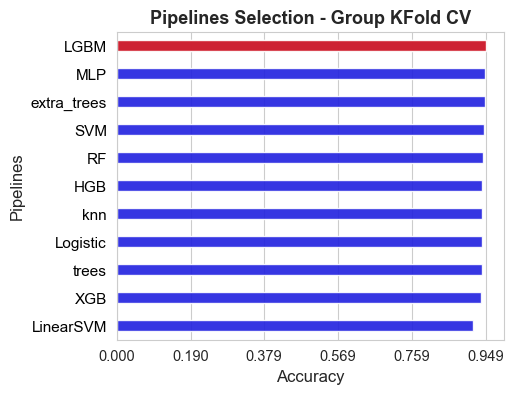

The best pipeline among all the 11 alternatives compared in this final stage, according to the inner evaluation, is: LGBM
Accuracy of the best pipeline:  0.949

The best pipeline hyper-parameters are:  {'scaler__apply': False, 'LGBM__max_depth': 23, 'LGBM__num_leaves': 71, 'LGBM__n_estimators': 120, 'LGBM__learning_rate': 0.005320673587684961, 'LGBM__lambda_l1': 0.008840401399518267, 'LGBM__lambda_l2': 0.002389872230017185, 'LGBM__min_split_gain': 0.0015901799134300236, 'LGBM__min_child_weight': 22, 'LGBM__feature_fraction': 0.75, 'features_extraction__statistics': 'mean-median-std'}


In [618]:
fig, axes = plt.subplots(figsize=(5,4))
ax = sns.barplot(y=list(sorted_models), x=list(sorted_scores), color='blue', width=0.4, alpha=0.9)
ax = sns.barplot(y=[best_pipeline_name], x=[score_best_pipeline], color='red', width=0.4, alpha=0.9)
ax.set_ylabel('Pipelines', size=12)
ax.set_xlabel('Accuracy', size=12)
ax.set_xticks(np.round(np.linspace(0, np.max(inner_score_values), 6),3)) 
ax.tick_params(axis='y', labelsize=11) 
ax.tick_params(axis='x', labelsize=10.5)    
plt.title('Pipelines Selection - Group KFold CV', size=13, weight='bold')
for label in ax.get_yticklabels():
    #label.set_weight('bold')
    label.set_color('black') 
plt.show()

print(f'The best pipeline among all the {len(sorted_scores)} alternatives compared in this final stage, according to the inner evaluation, is: {best_pipeline}')
print('Accuracy of the best pipeline: ', np.round(score_best_pipeline, 3))
print('\nThe best pipeline hyper-parameters are: ', best_params[best_pipeline_name])

#### **Defining the best pipeline**

Defining a general pipeline:

In [619]:
final_pipeline = Pipeline([
                    ('features_extraction', FeaturesExtractionHAR(blocks_size=sampling_freq, statistics='mean')),
                    ('scaler', scaler(apply=False, method='standard')),
                    (best_pipeline_name, models[best_pipeline_name]) 
                ])

Setting the best parameter to the defined pipeline:

In [620]:
final_pipeline.set_params(**best_params[best_pipeline_name])

Pipeline(steps=[('features_extraction',
                 FeaturesExtractionHAR(blocks_size=16,
                                       statistics='mean-median-std')),
                ('scaler', scaler()),
                ('LGBM',
                 LGBMClassifier(feature_fraction=0.75,
                                lambda_l1=0.008840401399518267,
                                lambda_l2=0.002389872230017185,
                                learning_rate=0.005320673587684961,
                                max_depth=23, min_child_weight=22,
                                min_split_gain=0.0015901799134300236,
                                n_estimators=120, num_leaves=71,
                                random_state=123, verbose=-1))])

## **Applying the outer evaluation**

### **Estimation of future performance**

In [621]:
final_pipeline.fit(X=X_HAR_train, y=Y_train)
Y_test_hat = final_pipeline.predict(X=X_HAR_test)
future_bal_acc = np.round(balanced_accuracy_score(y_pred=Y_test_hat, y_true=Y_test), 2)
future_acc = np.round(accuracy_score(y_pred=Y_test_hat, y_true=Y_test), 2)
print(f'The estimation of future performance of the best pipeline is:\n - In terms of balanced accuracy: {future_bal_acc}\n - In terms of accuracy: {future_acc}')

The estimation of future performance of the best pipeline is:
 - In terms of balanced accuracy: 0.97
 - In terms of accuracy: 0.99


#### **Confusion Matrix**

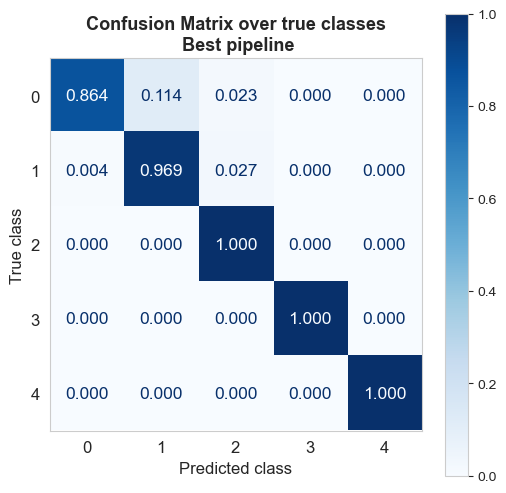

In [622]:
cm = confusion_matrix(y_pred=Y_test_hat, y_true=Y_test, normalize='true', labels=final_pipeline.classes_)
# normalize='true' to normalize over the rows (true classes)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=final_pipeline.classes_)

fig, axs = plt.subplots(figsize=(6,6))
disp.plot(ax=axs, cmap=plt.cm.Blues, values_format='.3f', text_kw={'fontsize': 12.5})
plt.title('Confusion Matrix over true classes\n Best pipeline', weight='bold', fontsize=13)
axs.set_xlabel('Predicted class', size=12)
axs.set_ylabel('True class', size=12)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.grid(False)
plt.show()

Remembering the meaning of the class labels, after applying label encoding: 0: Running, 1: Walking, 2: Standing, 3: Sitting, 4: Lying.


The performance of the best pipeline recognizing human activity is outstanding, specially in the walking, standing, sitting and lying activities.

The only activity in which the pipeline performs a bit worse is running, since the model misrecognize it as walking the 11.4 % of the times.

## **Saving the final pipeline**

We save the final (best) pipeline as a pre-training model after training it with all the available data.

In [623]:
final_pipeline.fit(X=X_HAR, y=Y)

# Save the pipeline to a file
with open(r'C:\Users\fscielzo\Documents\DataScience-GitHub\Human-Activity-Recognition\results\final_pipeline.pkl', 'wb') as file:
    pickle.dump(final_pipeline, file)

## **Predicting new data**

In this section we are going to recognize the activity of two new individuals from which we have data regarding the signals, in the same conditions as before, but we haven't the activity classes.

The point is to use the saved pre-trained pipeline to predict the activity of those new individuals based on their data about the signals.

First of all we load the pre-trained pipeline.

In [7]:
# Load the pipeline from file
with open(r'C:\Users\fscielzo\Documents\DataScience-GitHub\Human-Activity-Recognition\results\final_pipeline.pkl', 'rb') as file:
    loaded_pipeline = pickle.load(file)

Now we load the new data, process it a bit just to put it in a suitable format to be used by the pipeline, and, finally, we predict the activities for those signals using the pre-trained pipeline.

In [8]:
HAR_new_data = HAR_database['database_test']
n_new_individuals = len(HAR_new_data)
X_HAR_new = [HAR_new_data[i][0] for i in range(n_new_individuals)]
Y_new_hat = loaded_pipeline.predict(X=X_HAR_new)

In [9]:
Y_new_hat

array([3, 3, 3, ..., 3, 3, 3], dtype=uint8)

As before, activities are predicted for each second in which the signals were measured. 


For example, the recognized activity in the first second of activity for the first new individual is `3: Standing`, since `Y_new_hat[0] == 3`.

In the following code cell we collect certain information that will be used below, to present the recognized activities for the new individuals in a more elegant way.

In [10]:
blocks_size = loaded_pipeline.get_params()['features_extraction__blocks_size']
best_stats = loaded_pipeline.get_params()['features_extraction__statistics']
signals_block = loaded_pipeline.steps[0][1].signals_block
decoded_class_labels = {1: 'Running', 2: 'Walking', 3: 'Standing', 4: 'Sitting', 5: 'Lying'}
X_new, _,_ = get_X_features_HAR(X_HAR=X_HAR_new, blocks_size=blocks_size, statistics=best_stats)
new_individuals_idx = {}
for i in range(n_new_individuals):
    if i == 0:
        new_individuals_idx[i] = range(0, len(signals_block[i]))
    else:
        new_individuals_idx[i] = range(len(signals_block[i-1]), len(signals_block[i-1]) + len(signals_block[i]))

In [13]:
Y_new_hat_expanded = {}

for i in range(n_new_individuals):
    Y_new_hat_expanded[i] = []

    for j, r in enumerate(new_individuals_idx[i]):

        block_size = len(signals_block[i][j])
        time_secs = block_size/sampling_freq
        
        print('=========================================================================================================================')
        print(f' New Individual {i} - Block Number {j} - Block Size = {block_size} signals measurements - Block Time = {time_secs} seconds')
        print('=========================================================================================================================')
        print(f'\nINPUT --> Signals measurements:\n\n {signals_block[i][j]}\n\nPREPROCESSING (Features Extraction) --> Signals statistics ({best_stats}) for the block: \n\n {X_new[r]}\n\nOUTPUT (Recognized Activity) --> {decoded_class_labels[Y_new_hat[r]]}\n')
        
        # Here he expand the prediction for each bloch to each signal observation belonging to the block, in order to save them following the original format of the provided data.
        Y_new_hat_expanded[i].append(np.repeat(Y_new_hat[r], block_size))
    Y_new_hat_expanded[i] = np.concatenate(Y_new_hat_expanded[i])

 New Individual 0 - Block Number 0 - Block Size = 16 signals measurements - Block Time = 1.0 seconds

INPUT --> Signals measurements:

 [[-0.06516976  0.38268988 -0.2133753   0.18997728  0.13234735]
 [ 0.0188162   0.56415602  0.05981534  0.09126936  0.12937823]
 [ 0.02866381  0.53441247  0.10957474  0.06215636  0.15868741]
 [ 0.04405483  0.53172164  0.07782252  0.07026572  0.21301619]
 [ 0.07323893  0.33030948  0.04207259  0.10479012  0.25472851]
 [ 0.10348716  0.39947796  0.07482676  0.10607     0.24277312]
 [ 0.00382445  0.24056696  0.07427139  0.10105946  0.23303664]
 [-0.02644907  0.22729669  0.07213565  0.09636051  0.1450192 ]
 [ 0.00125242  0.17975689  0.05798641  0.09558193  0.11143713]
 [ 0.0887153   0.23176001  0.05140934  0.09096713  0.11414265]
 [ 0.09320141  0.14311734  0.03227439  0.09425283  0.11037175]
 [-0.00770817  0.20626431  0.01874265  0.09826403  0.08638627]
 [-0.0189568   0.18699118  0.00317415  0.10239344  0.06931742]
 [ 0.09620386  0.09242085 -0.00072207  0.1048

Saving the predictions for the new data in the same format as the original data. 

Our pipeline is able to predict the activity done by a human in each second of a given period of time during which their activity is recorded or monitored.
Our model predicts the activity for block of signal observations with a temporal size of 1 second, what means 16 observations, since the signingl had a sample frequency of 16 Hz.

But the original data has a periodicity of micro-seconds, specifically of 1/16 seconds. So, in the original format of the data, both signal and activity observations have a periodicity of 1/16 seconds.

In order to set the ou ractivity predictions in the original format we have applied an expansion strategy, what means to extrapolate the block predictions to each signal observation belonging to the block. So that, if the predictions made by our pipeline for a block of signals is 3 (standing), the predictions for each signal observation of that block will be 3 (standing) as well.

The expanded prediction were collected in the above cell and save in the dictionary `Y_new_hat_expanded`.

Now we save the new data predictions in the original data format:

In [17]:
HAR_new_database = {'__header__': b'MATLAB 5.0 MAT-file, Platform: MACI64, Created on: Thu May 16 17:05:45 2024',
                    '__version__': '1.0',
                    '__globals__': [],}

HAR_new_database['database_test'] = np.array([np.array([HAR_database['database_test'][i][0], Y_new_hat_expanded[i]], dtype=object) for i in range(len(Y_new_hat_expanded))])

# Save the data to a MATLAB file
savemat(r'C:\Users\fscielzo\Documents\DataScience-GitHub\Human-Activity-Recognition\results\HAR_new_database.mat', HAR_new_database)

In [18]:
HAR_new_database

{'__header__': b'MATLAB 5.0 MAT-file, Platform: MACI64, Created on: Thu May 16 17:05:45 2024',
 '__version__': '1.0',
 '__globals__': [],
 'database_test': array([[array([[-0.06516976,  0.0188162 ,  0.02866381, ..., -0.65489655,
                 -0.50250338, -0.59326978],
                [ 0.38268988,  0.56415602,  0.53441247, ...,  3.26943227,
                  3.36463946,  3.41075882],
                [-0.2133753 ,  0.05981534,  0.10957474, ..., -0.04022603,
                 -0.03728265, -0.01322535],
                [ 0.18997728,  0.09126936,  0.06215636, ...,  0.11363941,
                  0.09155738,  0.10077387],
                [ 0.13234735,  0.12937823,  0.15868741, ...,  0.0875492 ,
                  0.0407315 ,  0.06236758]])                             ,
         array([3, 3, 3, ..., 4, 4, 4], dtype=uint8)],
        [array([[-8.41940561e-01, -3.53763629e-02, -3.64637935e-01, ...,
                 -4.72952179e-03, -1.60836501e-02,  3.36982094e-03],
                [ 1.2211178

## **Conclusions**

In this project, we have developed a pipeline for human activity recognition using signal data. We started by preprocessing the data and extracting relevant features. We then trained multiple machine learning models and evaluated their performance using cross-validation.

After evaluating the models, we selected the best pipeline based on its performance. The selected pipeline achieved outstanding accuracy in recognizing human activities, with high accuracy for walking, standing, sitting, and lying activities. However, it had a slightly lower accuracy for the running activity.

We saved the final pipeline as a pre-trained model and used it to predict the activities of new individuals based on their signal data. The predictions were saved in the original data format for further analysis.

Overall, this project demonstrates the effectiveness of using machine learning techniques for human activity recognition. The developed pipeline can be used in various applications, such as healthcare monitoring and fitness tracking. Further improvements can be made by exploring different feature extraction techniques and optimizing the model hyperparameters. We can say that the project objective has been fulfilled.